<a href="https://colab.research.google.com/github/JyresaMae/Digital-Signal-Processing/blob/Sound-%26-Signals/Sounds_and_Signals.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Exercise 1**

In [ ]:
from thinkdsp import read_wave

wave = read_wave('701970__josefpres__piano-loops-120-octave-long-loop-120-bpm.wav')
wave.normalize()
wave.make_audio()

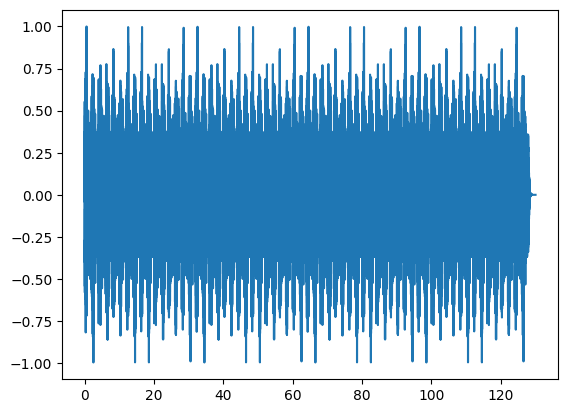

In [ ]:
wave.plot()

By trial and error, I selected a segment with a constant pitch/melody of the piano

In [ ]:
segment = wave.segment(start=1.1, duration=0.3)
segment.make_audio()

The corresponding segment of the sound looks like:

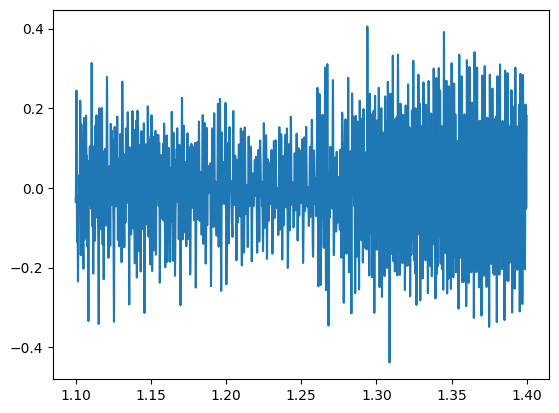

In [ ]:
segment.plot()

And here's an even shorter segment so you can see the waveform:

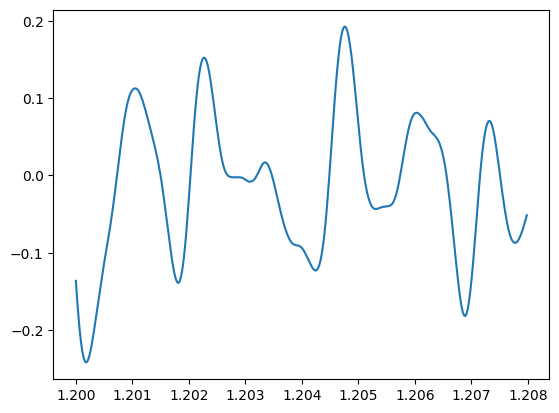

In [ ]:
segment.segment(start=1.2, duration=0.008).plot()

Here's what the spectrum looks like:

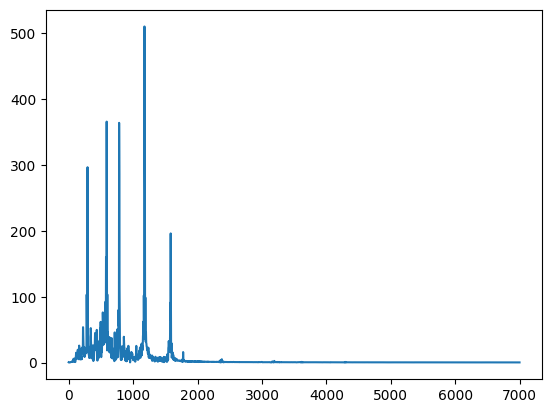

In [ ]:
spectrum = segment.make_spectrum()
spectrum.plot(high=7000)

It has lots of frequency components. Let's zoom in on the fundamental and dominant frequencies:

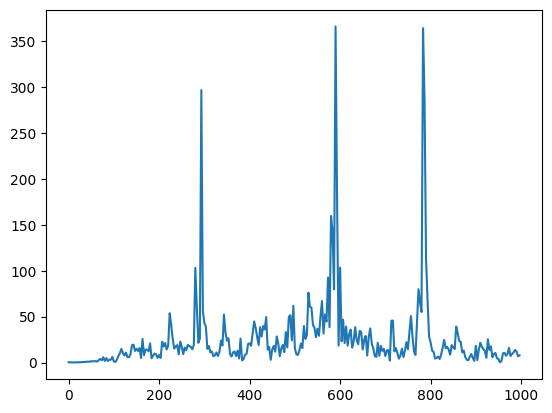

In [ ]:
spectrum = segment.make_spectrum()
spectrum.plot(high=1000)

`peaks` prints the highest points in the spectrum and their frequencies, in descending order:

In [ ]:
spectrum.peaks()[:30]

[(510.4186256683198, 1176.6666666666667),
 (365.90585093373477, 590.0),
 (364.04671464451536, 783.3333333333334),
 (319.77097348282064, 1180.0),
 (296.6572388445731, 293.33333333333337),
 (285.92717790714244, 786.6666666666667),
 (258.24065652243496, 1183.3333333333335),
 (239.51997106294905, 1173.3333333333335),
 (196.10832912447117, 1583.3333333333335),
 (177.85223096345194, 593.3333333333334),
 (159.64050529642932, 580.0),
 (142.4745651026994, 583.3333333333334),
 (112.54342976912832, 790.0),
 (103.45721189417513, 600.0),
 (103.18646059546165, 280.0),
 (101.94807948739047, 1166.6666666666667),
 (98.81671372194407, 1190.0),
 (92.63456846166721, 573.3333333333334),
 (90.78333090947368, 1576.6666666666667),
 (79.92318360003631, 1586.6666666666667),
 (79.89917442156442, 773.3333333333334),
 (79.88710423875555, 586.6666666666667),
 (76.12850611071691, 530.0),
 (67.77316641581062, 793.3333333333334),
 (66.99232425590753, 560.0),
 (65.48687909714654, 776.6666666666667),
 (65.18668670331455

Next we can filter out the high frequencies using the filters which are `low_pass`,` high_pass`, & `band_stop`

In [ ]:
spectrum.low_pass(3000)

And here's what it sounds like:

In [ ]:
spectrum.make_wave().make_audio()

You can choose a section and use various filters in the interaction that follows. The sample will sound like it would over an analog (not digital) phone line if the cutoff is set at 3400 Hz.

In [ ]:
from thinkdsp import decorate
from IPython.display import display

def filter_wave(wave, start, duration, cutoff):
    segment = wave.segment(start, duration)
    spectrum = segment.make_spectrum()

    spectrum.plot(high=5000, color='0.7')
    spectrum.low_pass(cutoff)
    spectrum.plot(high=5000, color='#045a8d')
    decorate(xlabel='Frequency (Hz)')

    audio = spectrum.make_wave().make_audio()
    display(audio)

interactive(children=(FloatSlider(value=2.0, description='start', max=5.0), FloatSlider(value=2.0, description…

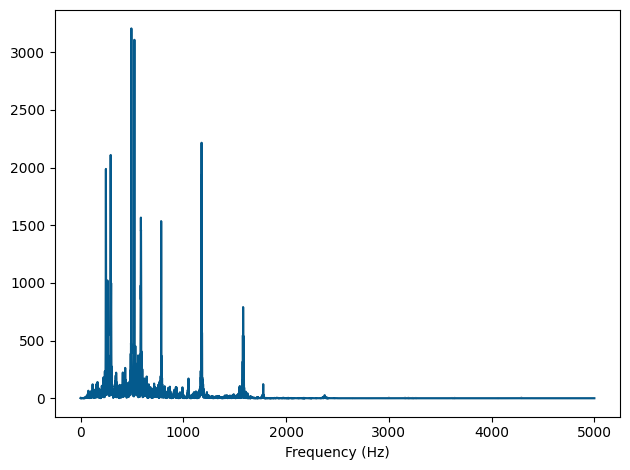

In [ ]:
from ipywidgets import interact, fixed

interact(filter_wave, wave=fixed(wave),
         start=(0, 5, 0.1), duration=(0, 5, 0.1), cutoff=(0, 5000, 100));

**Exercise 2**

Generate sine and cosine signals.

In [ ]:
from thinkdsp import CosSignal, SinSignal

cos_sig = CosSignal(freq=300, amp=1.0, offset=0)
sin_sig = SinSignal(freq=900, amp=0.5, offset=0)

Plotting cosine signals by default produces a `plot` with three periods.

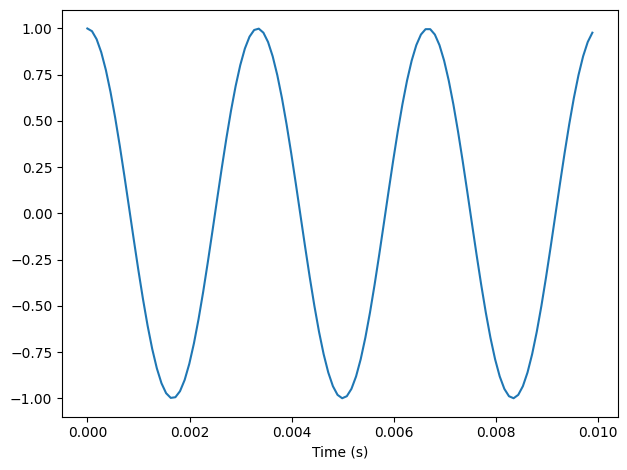

In [ ]:
from thinkdsp import decorate

cos_sig.plot()
decorate(xlabel='Time (s)')

We can use the cosine signal to make a wave and sound from it:

In [ ]:
wave2 = cos_sig.make_wave(duration=1)
wave2.apodize()

In [ ]:
wave2.make_audio()

The elements combine to produce a tone that sounds cohesive since they are all multiples of 300 Hz.

The spectrum appears as follows:

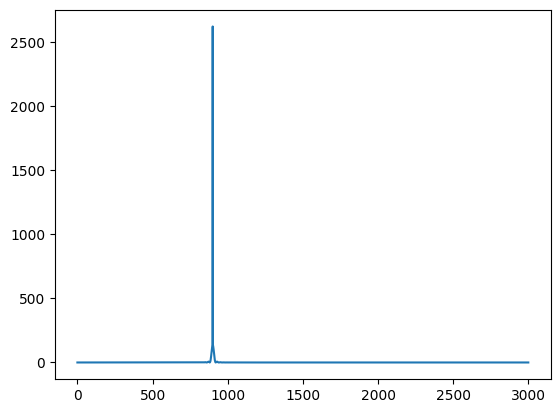

In [ ]:
spectrum = wave2.make_spectrum()
spectrum.plot(high=3000)

cos_sig += CosSignal(freq=650)
cos_sig.make_wave().make_audio()

Same cosine signals in plotting sine signals by default produces a `plot` with three periods.

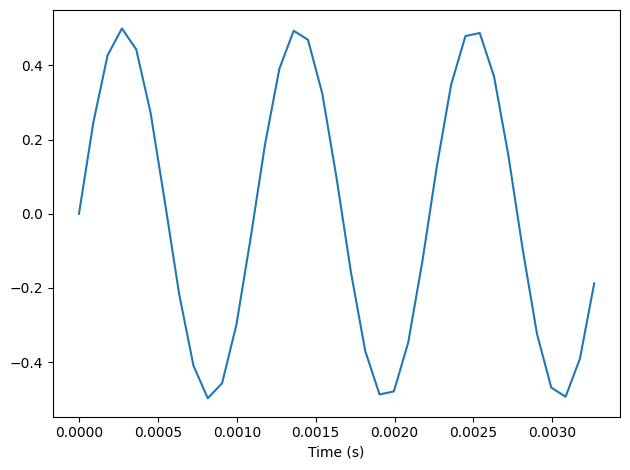

In [ ]:
sin_sig.plot()
decorate(xlabel='Time (s)')

We can use the sine signal to make a wave and sound from it:

In [ ]:
wave3 = sin_sig.make_wave(duration=1)
wave3.apodize()
wave3.make_audio()

The elements combine to produce a tone that sounds cohesive since they are all multiples of 300 Hz.

The spectrum appears as follows:

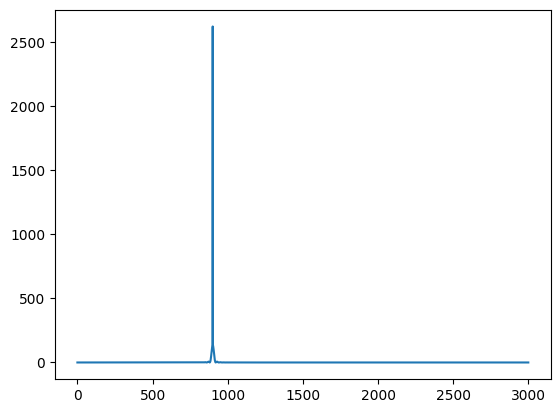

In [ ]:
spectrum = wave3.make_spectrum()
spectrum.plot(high=3000)

sin_sig += SinSignal(freq=650)
sin_sig.make_wave().make_audio()

Combining the cosine and sine signals:

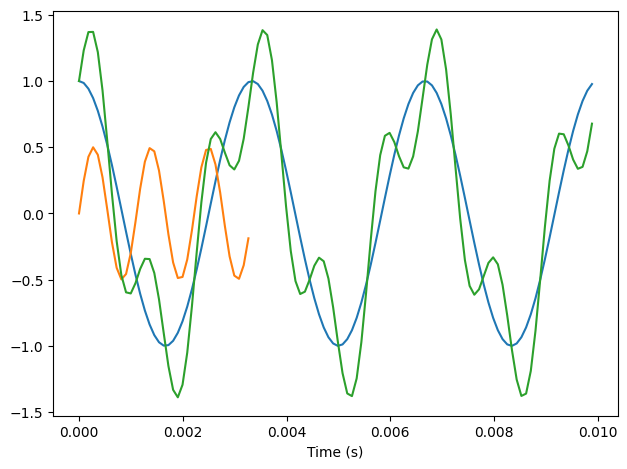

In [ ]:
cos_sig = CosSignal(freq=300, amp=1.0, offset=0)
sin_sig = SinSignal(freq=900, amp=0.5, offset=0)

cos_sig.plot()
sin_sig.plot()


mix = sin_sig + cos_sig
mix.plot()
decorate(xlabel='Time (s)')

We can use the signal to make a wave and sound from it:

In [ ]:
wave4 = mix.make_wave(duration=1)
wave4.apodize()
wave4.make_audio()

Here's what the spectrum looks like with the corresponding sound from the wave:

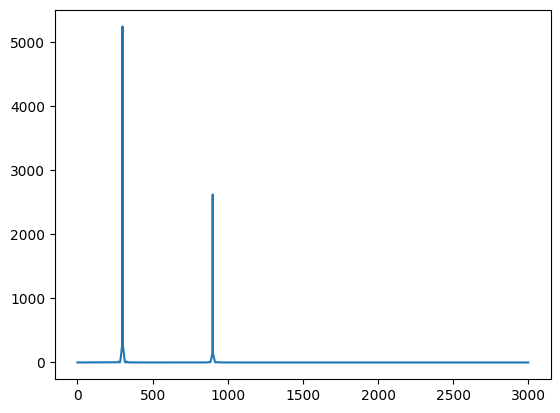

In [ ]:
spectrum = wave4.make_spectrum()
spectrum.plot(high=3000)

mix += SinSignal(freq=650) + CosSignal(freq=650)
mix.make_wave().make_audio()

EXERCISE 3

Using the original sound:

In [ ]:
wave5 = read_wave ('701970__josefpres__piano-loops-120-octave-long-loop-120-bpm.wav')
wave5.normalize()
wave5.make_audio()

Here's the implementation of `stretch` and `framerate`

In [ ]:
def stretch(wave, factor):
    wave.ts *= factor
    wave.framerate /= factor

And this is how it would sound if we doubled the speed.

In [ ]:
stretch(wave5, 0.5)
wave5.make_audio()

To ensure that the `ts` was appropriately changed, here is how it appears.

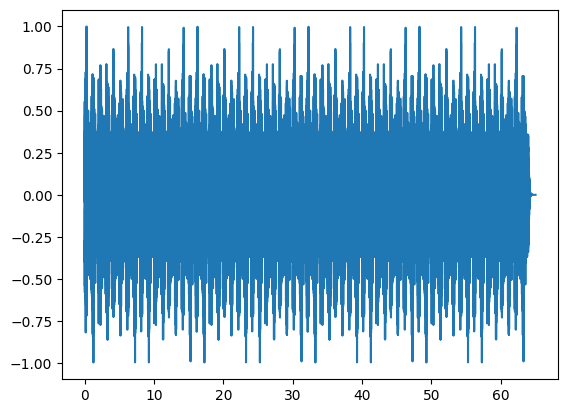

In [ ]:
wave5.plot()